In [1]:
import pandas as pd    
import numpy as np
from models import *
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
import bar_chart_race as bcr
import Levenshtein

In [2]:
warnings.simplefilter(action='ignore', category=pd.errors.SettingWithCopyWarning)

In [3]:
data = pd.read_excel("../scrapers/cleaned_data_2024/final_data_regata.xlsx")

In [210]:
for classe in ["ILCA 7", "ILCA 6", "49ER", "49ERFX", "IQFOIL FEM."]:

    data_temp = data[data['Classe Vela'] == classe]

    for k_elo in [20, 40, 100]:

        elo = EloRating(ratings={competitor: 1500 for competitor in data_temp['Nome Competidor'].unique()}, k=k_elo)

        # Extrair o ano da competição e adicioná-lo ao dataframe
        for competition in data_temp['Nome Competição']:
            data_temp.loc[data_temp['Nome Competição'] == competition, 'Ano'] = int(re.findall(r'\d{4}', competition)[0])

        # Agrupar os dados por ano, competição, regata e competidor
        grouped_data = data_temp.groupby(["Ano", "Nome Competição", "Regata", "Nome Competidor"]).agg({"Posição Geral": "min"}).sort_values(by=["Ano", "Nome Competição", "Regata", "Posição Geral"], ascending=True).reset_index()

        # Preparar os dados no formato necessário para o cálculo do erro
        data_dict = []
        for ano in grouped_data["Ano"].unique():
            for comp in grouped_data[grouped_data["Ano"] == ano]["Nome Competição"].unique():
                for regata in grouped_data[(grouped_data["Ano"] == ano) & (grouped_data["Nome Competição"] == comp)]["Regata"].unique():
                    results = grouped_data[(grouped_data["Ano"] == ano) & (grouped_data["Nome Competição"] == comp) & (grouped_data["Regata"] == regata)]["Posição Geral"].values
                    names = grouped_data[(grouped_data["Ano"] == ano) & (grouped_data["Nome Competição"] == comp) & (grouped_data["Regata"] == regata)]["Nome Competidor"].values
                    data_dict.append([results, names])

        # Treinar o modelo ELO com os dados
        elo.fit(data_dict)
        ratings = elo.ratings

        ratings = pd.DataFrame.from_dict(ratings, orient='index', columns=['Rating']).sort_values(by="Rating")
        ratings.to_csv('../rankings_2024/novo/regata/elo-' + str(k_elo) + '-' + f"{classe}_regata" + '.csv')

In [211]:
for classe in ["ILCA 7", "ILCA 6", "49ER", "49ERFX", "IQFOIL FEM."]:

    data_temp = data[data['Classe Vela'] == classe]

    for k_elo in [20, 40, 100]:

        elo = EloRating(ratings={competitor: 1500 for competitor in data_temp['Nome Competidor'].unique()}, k=k_elo)
        for competition in data_temp['Nome Competição']:
            data_temp.loc[data_temp['Nome Competição'] == competition, 'Ano'] = int(re.findall(r'\d{4}', competition)[0])

        # get data in the format needed for error calculation
        data_dict = []
        grouped_data = data_temp.groupby(["Ano","Nome Competição", "Nome Competidor", ]).agg({"Posição Geral": "min"}
            ).sort_values(by=["Ano", "Nome Competição", "Posição Geral"], ascending=True).reset_index()

        for ano in grouped_data["Ano"].unique():
            for comp in grouped_data[grouped_data["Ano"] == ano]["Nome Competição"].unique():
                results = grouped_data[(grouped_data["Ano"] == ano) & (grouped_data["Nome Competição"] == comp)]["Posição Geral"].values
                names = grouped_data[(grouped_data["Ano"] == ano) & (grouped_data["Nome Competição"] == comp)]["Nome Competidor"].values
                data_dict.append([results, names])

        elo.fit(data_dict)
        ratings = elo.ratings

        ratings = pd.DataFrame.from_dict(ratings, orient='index', columns=['Rating']).sort_values(by="Rating")
        ratings.to_csv('../rankings_2024/novo/normal/elo-' + str(k_elo) + '-' + classe + '.csv')

# ILCA 7

In [212]:
elo_20 = pd.read_csv("../rankings_2024/novo/regata/elo-20-ILCA 7_regata.csv")
elo_40 = pd.read_csv("../rankings_2024/novo/regata/elo-40-ILCA 7_regata.csv")
elo_100 = pd.read_csv("../rankings_2024/novo/regata/elo-100-ILCA 7_regata.csv")

elo_20_normal = pd.read_csv("../rankings_2024/novo/normal/elo-20-ILCA 7.csv")
elo_40_normal = pd.read_csv("../rankings_2024/novo/normal/elo-40-ILCA 7.csv")
elo_100_normal = pd.read_csv("../rankings_2024/novo/normal/elo-100-ILCA 7.csv")

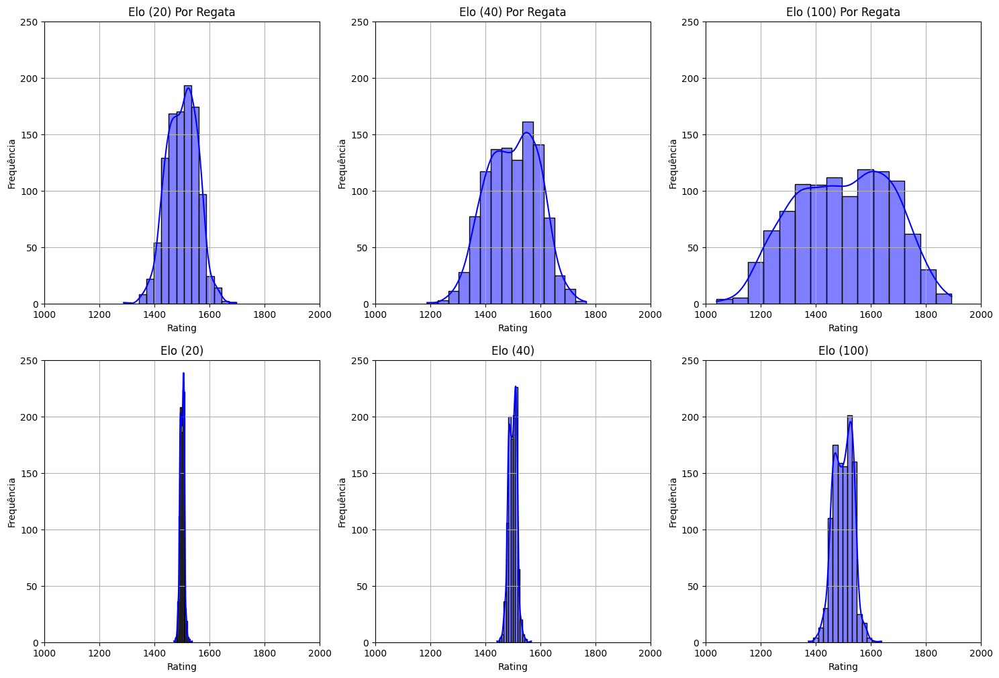

In [213]:
fig, axes = plt.subplots(2, 3, figsize=(18, 12))

sns.histplot(elo_20["Rating"], bins=15, kde=True, color='blue', ax=axes[0, 0]);
axes[0, 0].set_xlim(1000, 2000);
axes[0, 0].set_ylim(0, 250);
axes[0, 0].set_title('Elo (20) Por Regata')
axes[0, 0].set_xlabel('Rating');
axes[0, 0].set_ylabel('Frequência');
axes[0, 0].grid(True);

sns.histplot(elo_40["Rating"], bins=15, kde=True, color='blue', ax=axes[0, 1]);
axes[0, 1].set_xlim(1000, 2000);
axes[0, 1].set_ylim(0, 250);
axes[0, 1].set_title('Elo (40) Por Regata');
axes[0, 1].set_xlabel('Rating');
axes[0, 1].set_ylabel('Frequência');
axes[0, 1].grid(True);

sns.histplot(elo_100["Rating"], bins=15, kde=True, color='blue', ax=axes[0, 2]);
axes[0, 2].set_xlim(1000, 2000);
axes[0, 2].set_ylim(0, 250);
axes[0, 2].set_title('Elo (100) Por Regata');
axes[0, 2].set_xlabel('Rating');
axes[0, 2].set_ylabel('Frequência');
axes[0, 2].grid(True);

sns.histplot(elo_20_normal["Rating"], bins=15, kde=True, color='blue', ax=axes[1, 0]);
axes[1, 0].set_xlim(1000, 2000);
axes[1, 0].set_ylim(0, 250);
axes[1, 0].set_title('Elo (20)')
axes[1, 0].set_xlabel('Rating');
axes[1, 0].set_ylabel('Frequência');
axes[1, 0].grid(True);

sns.histplot(elo_40_normal["Rating"], bins=15, kde=True, color='blue', ax=axes[1, 1]);
axes[1, 1].set_xlim(1000, 2000);
axes[1, 1].set_ylim(0, 250);
axes[1, 1].set_title('Elo (40)')
axes[1, 1].set_xlabel('Rating');
axes[1, 1].set_ylabel('Frequência');
axes[1, 1].grid(True);

sns.histplot(elo_100_normal["Rating"], bins=15, kde=True, color='blue', ax=axes[1, 2]);
axes[1, 2].set_xlim(1000, 2000);
axes[1, 2].set_ylim(0, 250);
axes[1, 2].set_title('Elo (100)')
axes[1, 2].set_xlabel('Rating');
axes[1, 2].set_ylabel('Frequência');
axes[1, 2].grid(True);

In [214]:
elo_40.tail(10)

,Unnamed: 0,Rating
1047,CVINAR ALEC,1697.290796
1048,CALEB ARMIT,1697.365145
1049,SPADONI ALESSIO,1705.365285
1050,NORMAN STRUTHERS,1706.332373
1051,ELLIOT HANSON,1715.314265
1052,ALEXANDER FINN,1721.177146
1053,CHUSIT PUNJAMALA,1722.376296
1054,GITESH NAIN,1726.688821
1055,RICARDO SEGUEL LACAMARA,1746.152861
1056,THOMAS SAUNDERS,1766.740715


In [215]:
elo_40_normal.tail(10)

,Unnamed: 0,Rating
1047,NORMAN STRUTHERS,1535.389958
1048,CHUSIT PUNJAMALA,1536.143630
1049,SPADONI ALESSIO,1537.217783
1050,FLORIAN HAFNER,1537.417834
1051,MICHAEL BECKETT,1541.336160
1052,FILIP JURISIC,1542.148214
1053,KARL-MARTIN RAMMO,1543.681754
1054,MALCOLM BENN SMITH,1544.251334
1055,RICARDO SEGUEL LACAMARA,1548.657440
1056,THOMAS SAUNDERS,1567.435201


# ILCA 6

In [216]:
elo_20_ilca6 = pd.read_csv("../rankings_2024/novo/regata/elo-20-ILCA 6_regata.csv")
elo_40_ilca6 = pd.read_csv("../rankings_2024/novo/regata/elo-40-ILCA 6_regata.csv")
elo_100_ilca6 = pd.read_csv("../rankings_2024/novo/regata/elo-100-ILCA 6_regata.csv")

elo_20_normal_ilca6 = pd.read_csv("../rankings_2024/novo/normal/elo-20-ILCA 6.csv")
elo_40_normal_ilca6 = pd.read_csv("../rankings_2024/novo/normal/elo-40-ILCA 6.csv")
elo_100_normal_ilca6 = pd.read_csv("../rankings_2024/novo/normal/elo-100-ILCA 6.csv")

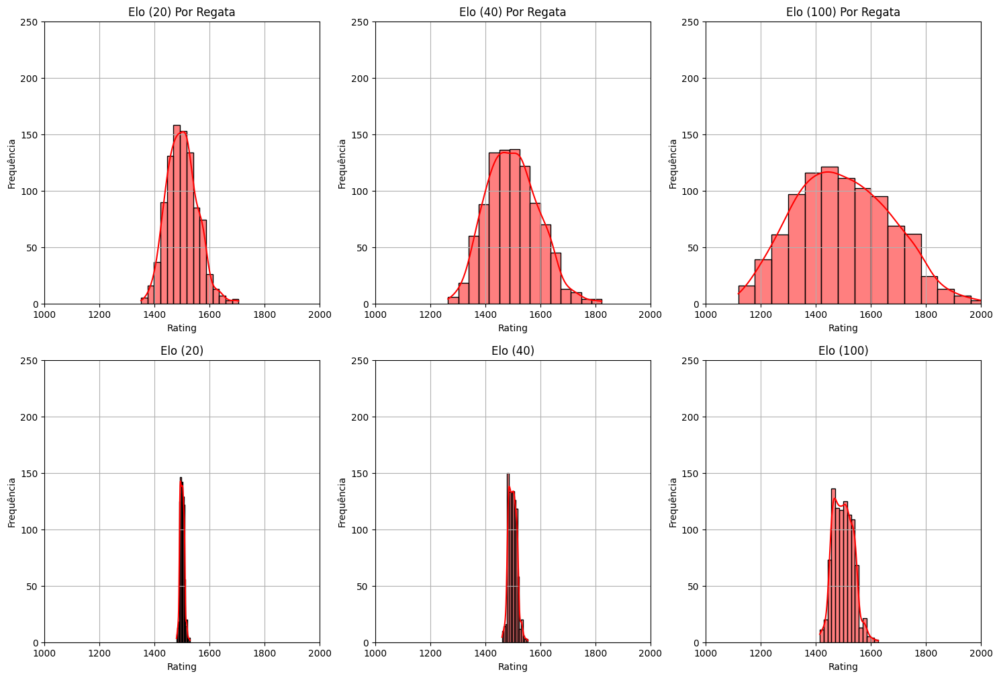

In [217]:
fig, axes = plt.subplots(2, 3, figsize=(18, 12))

sns.histplot(elo_20_ilca6["Rating"], bins=15, kde=True, color='red', ax=axes[0, 0]);
axes[0, 0].set_xlim(1000, 2000);
axes[0, 0].set_ylim(0, 250);
axes[0, 0].set_title('Elo (20) Por Regata')
axes[0, 0].set_xlabel('Rating');
axes[0, 0].set_ylabel('Frequência');
axes[0, 0].grid(True);

sns.histplot(elo_40_ilca6["Rating"], bins=15, kde=True, color='red', ax=axes[0, 1]);
axes[0, 1].set_xlim(1000, 2000);
axes[0, 1].set_ylim(0, 250);
axes[0, 1].set_title('Elo (40) Por Regata');
axes[0, 1].set_xlabel('Rating');
axes[0, 1].set_ylabel('Frequência');
axes[0, 1].grid(True);

sns.histplot(elo_100_ilca6["Rating"], bins=15, kde=True, color='red', ax=axes[0, 2]);
axes[0, 2].set_xlim(1000, 2000);
axes[0, 2].set_ylim(0, 250);
axes[0, 2].set_title('Elo (100) Por Regata');
axes[0, 2].set_xlabel('Rating');
axes[0, 2].set_ylabel('Frequência');
axes[0, 2].grid(True);

sns.histplot(elo_20_normal_ilca6["Rating"], bins=15, kde=True, color='red', ax=axes[1, 0]);
axes[1, 0].set_xlim(1000, 2000);
axes[1, 0].set_ylim(0, 250);
axes[1, 0].set_title('Elo (20)')
axes[1, 0].set_xlabel('Rating');
axes[1, 0].set_ylabel('Frequência');
axes[1, 0].grid(True);

sns.histplot(elo_40_normal_ilca6["Rating"], bins=15, kde=True, color='red', ax=axes[1, 1]);
axes[1, 1].set_xlim(1000, 2000);
axes[1, 1].set_ylim(0, 250);
axes[1, 1].set_title('Elo (40)')
axes[1, 1].set_xlabel('Rating');
axes[1, 1].set_ylabel('Frequência');
axes[1, 1].grid(True);

sns.histplot(elo_100_normal_ilca6["Rating"], bins=15, kde=True, color='red', ax=axes[1, 2]);
axes[1, 2].set_xlim(1000, 2000);
axes[1, 2].set_ylim(0, 250);
axes[1, 2].set_title('Elo (100)')
axes[1, 2].set_xlabel('Rating');
axes[1, 2].set_ylabel('Frequência');
axes[1, 2].grid(True);

In [218]:
elo_40_ilca6.tail(10)

,Unnamed: 0,Rating
926,CASEY IMENEO,1731.580623
927,THOMSON ZOE,1745.294675
928,SARAH DOUGLAS,1750.282499
929,HANNAH SNELLGROVE,1750.935600
930,MARIE BARRUE,1758.492413
931,ANNA MUNCH,1764.333634
932,ERIKA REINEKE,1793.144228
933,MIRTHE AKKERMAN,1806.309586
934,EVI VAN ACKER,1808.696554
935,MICHON PERNELLE,1822.895450


In [219]:
elo_40_normal_ilca6.tail(10)

,Unnamed: 0,Rating
926,MARIA ERDI,1538.685997
927,ANNA MUNCH,1539.319610
928,SARAH DOUGLAS,1539.493717
929,ALEXANDER DE BIE,1542.088343
930,ERIKA REINEKE,1546.034555
931,MARIE BARRUE,1546.957807
932,LUCIA FALASCA,1547.694855
933,MIRTHE AKKERMAN,1549.056048
934,MICHON PERNELLE,1552.664773
935,EVI VAN ACKER,1555.267098


# 49ER

In [220]:
elo_20_49er = pd.read_csv("../rankings_2024/novo/regata/elo-20-49ER_regata.csv")
elo_40_49er = pd.read_csv("../rankings_2024/novo/regata/elo-40-49ER_regata.csv")
elo_100_49er = pd.read_csv("../rankings_2024/novo/regata/elo-100-49ER_regata.csv")

elo_20_normal_49er = pd.read_csv("../rankings_2024/novo/normal/elo-20-49ER.csv")
elo_40_normal_49er = pd.read_csv("../rankings_2024/novo/normal/elo-40-49ER.csv")
elo_100_normal_49er = pd.read_csv("../rankings_2024/novo/normal/elo-100-49ER.csv")

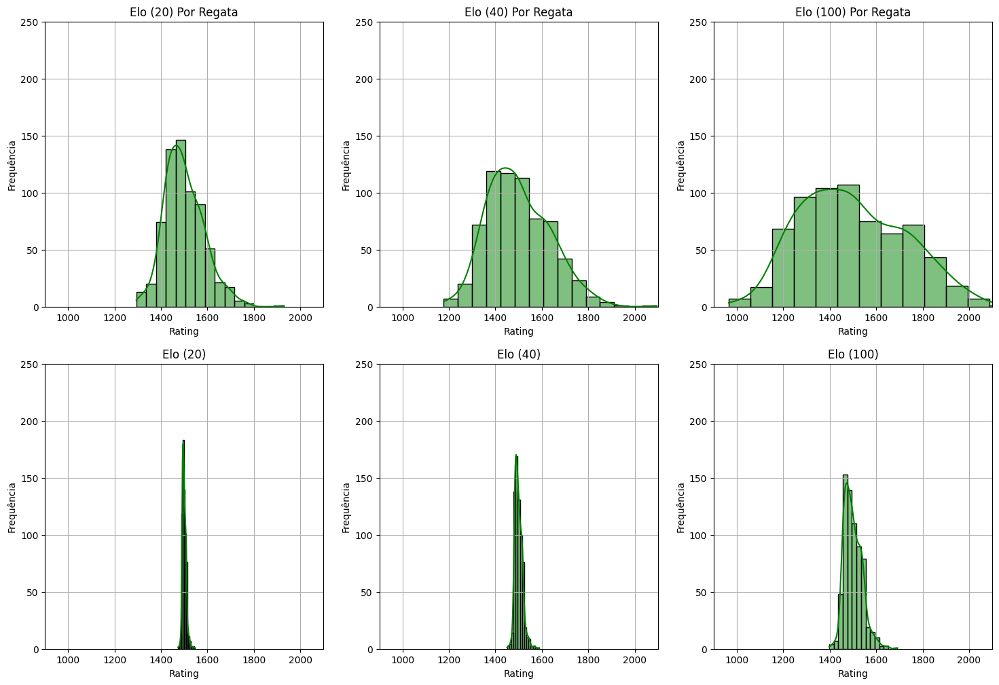

In [221]:
fig, axes = plt.subplots(2, 3, figsize=(18, 12))

sns.histplot(elo_20_49er["Rating"], bins=15, kde=True, color='green', ax=axes[0, 0]);
axes[0, 0].set_xlim(900, 2100);
axes[0, 0].set_ylim(0, 250);
axes[0, 0].set_title('Elo (20) Por Regata')
axes[0, 0].set_xlabel('Rating');
axes[0, 0].set_ylabel('Frequência');
axes[0, 0].grid(True);

sns.histplot(elo_40_49er["Rating"], bins=15, kde=True, color='green', ax=axes[0, 1]);
axes[0, 1].set_xlim(900, 2100);
axes[0, 1].set_ylim(0, 250);
axes[0, 1].set_title('Elo (40) Por Regata');
axes[0, 1].set_xlabel('Rating');
axes[0, 1].set_ylabel('Frequência');
axes[0, 1].grid(True);

sns.histplot(elo_100_49er["Rating"], bins=15, kde=True, color='green', ax=axes[0, 2]);
axes[0, 2].set_xlim(900, 2100);
axes[0, 2].set_ylim(0, 250);
axes[0, 2].set_title('Elo (100) Por Regata');
axes[0, 2].set_xlabel('Rating');
axes[0, 2].set_ylabel('Frequência');
axes[0, 2].grid(True);

sns.histplot(elo_20_normal_49er["Rating"], bins=15, kde=True, color='green', ax=axes[1, 0]);
axes[1, 0].set_xlim(900, 2100);
axes[1, 0].set_ylim(0, 250);
axes[1, 0].set_title('Elo (20)')
axes[1, 0].set_xlabel('Rating');
axes[1, 0].set_ylabel('Frequência');
axes[1, 0].grid(True);

sns.histplot(elo_40_normal_49er["Rating"], bins=15, kde=True, color='green', ax=axes[1, 1]);
axes[1, 1].set_xlim(900, 2100);
axes[1, 1].set_ylim(0, 250);
axes[1, 1].set_title('Elo (40)')
axes[1, 1].set_xlabel('Rating');
axes[1, 1].set_ylabel('Frequência');
axes[1, 1].grid(True);

sns.histplot(elo_100_normal_49er["Rating"], bins=15, kde=True, color='green', ax=axes[1, 2]);
axes[1, 2].set_xlim(900, 2100);
axes[1, 2].set_ylim(0, 250);
axes[1, 2].set_title('Elo (100)')
axes[1, 2].set_xlabel('Rating');
axes[1, 2].set_ylabel('Frequência');
axes[1, 2].grid(True);

In [222]:
elo_40_49er.tail(10)

,Unnamed: 0,Rating
670,"IAN BARROWS, MITCHELL KISS",1817.994248
671,"SIMONE FERRARESE, LEONARDO CHISTE",1825.816799
672,"MIKOLAJ STANIUL, KUBA SZTORCH",1829.741051
673,"ANDREW MOLLERUS, IAN MACDIARMID",1832.160930
674,"DOMINIK BUKSAK, SZYMON WIERZBICKI",1850.523680
675,"NEVIN SNOW, DANE WILSON",1858.027265
676,"ERWAN FISCHER, CLEMENT PEQUIN",1869.030702
677,"CHRIS TAYLOR, RHOS HAWES",1874.997913
678,"BART LAMBRIEX, FLORIS VAN DE WERKEN",1914.024337
679,"PETER BURLING, BLAIR TUKE",2095.271284


In [223]:
elo_40_normal_49er.tail(10)

,Unnamed: 0,Rating
670,"HERNAN UMPIERRE, FERNANDO DIZ",1548.021386
671,"MIKOLAJ STANIUL, KUBA SZTORCH",1548.325132
672,"JAKOB MEGGENDORFER, ANDREAS SPRANGER",1548.813823
673,"SIME FANTELA, MIHOVIL FANTELA",1552.618183
674,"ERWAN FISCHER, CLEMENT PEQUIN",1555.592819
675,"CHRIS TAYLOR, RHOS HAWES",1564.976397
676,"ISAAC , MCHARDIE, WILLIAM , MCKENZIE",1567.435652
677,"TIM FISCHER, FABIAN GRAF",1567.475690
678,"DOMINIK BUKSAK, SZYMON WIERZBICKI",1576.717715
679,"PETER BURLING, BLAIR TUKE",1588.705877


# 49ERFX

In [224]:
elo_20_49erfx = pd.read_csv("../rankings_2024/novo/regata/elo-20-49ERFX_regata.csv")
elo_40_49erfx = pd.read_csv("../rankings_2024/novo/regata/elo-40-49ERFX_regata.csv")
elo_100_49erfx = pd.read_csv("../rankings_2024/novo/regata/elo-100-49ERFX_regata.csv")

elo_20_normal_49erfx = pd.read_csv("../rankings_2024/novo/normal/elo-20-49ERFX.csv")
elo_40_normal_49erfx = pd.read_csv("../rankings_2024/novo/normal/elo-40-49ERFX.csv")
elo_100_normal_49erfx = pd.read_csv("../rankings_2024/novo/normal/elo-100-49ERFX.csv")

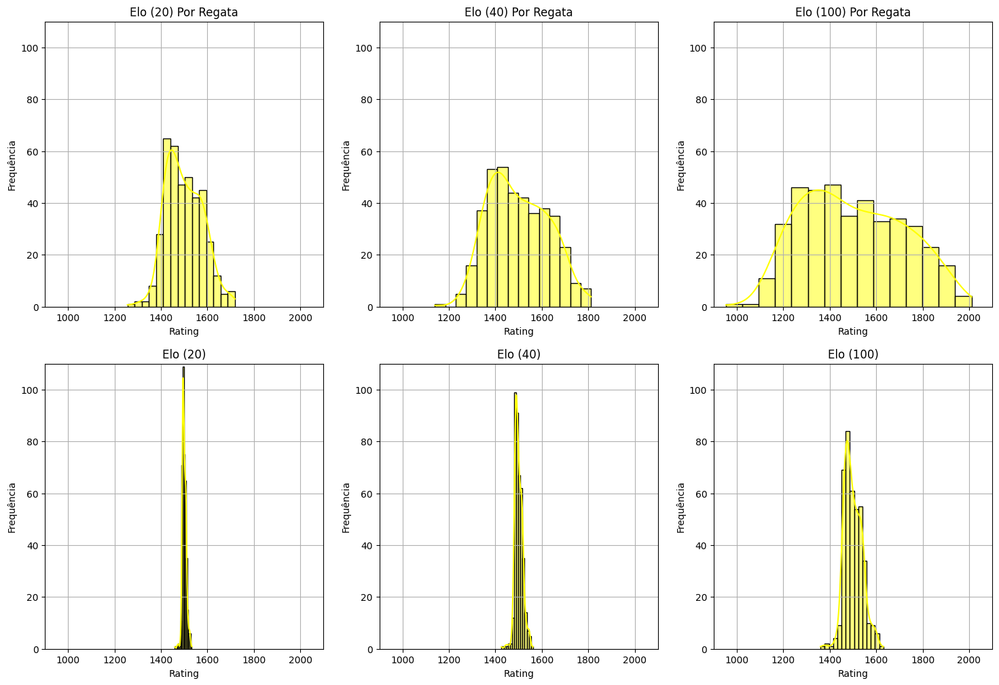

In [225]:
fig, axes = plt.subplots(2, 3, figsize=(18, 12))

sns.histplot(elo_20_49erfx["Rating"], bins=15, kde=True, color='yellow', ax=axes[0, 0]);
axes[0, 0].set_xlim(900, 2100);
axes[0, 0].set_ylim(0, 110);
axes[0, 0].set_title('Elo (20) Por Regata')
axes[0, 0].set_xlabel('Rating');
axes[0, 0].set_ylabel('Frequência');
axes[0, 0].grid(True);

sns.histplot(elo_40_49erfx["Rating"], bins=15, kde=True, color='yellow', ax=axes[0, 1]);
axes[0, 1].set_xlim(900, 2100);
axes[0, 1].set_ylim(0, 110);
axes[0, 1].set_title('Elo (40) Por Regata');
axes[0, 1].set_xlabel('Rating');
axes[0, 1].set_ylabel('Frequência');
axes[0, 1].grid(True);

sns.histplot(elo_100_49erfx["Rating"], bins=15, kde=True, color='yellow', ax=axes[0, 2]);
axes[0, 2].set_xlim(900, 2100);
axes[0, 2].set_ylim(0, 110);
axes[0, 2].set_title('Elo (100) Por Regata');
axes[0, 2].set_xlabel('Rating');
axes[0, 2].set_ylabel('Frequência');
axes[0, 2].grid(True);

sns.histplot(elo_20_normal_49erfx["Rating"], bins=15, kde=True, color='yellow', ax=axes[1, 0]);
axes[1, 0].set_xlim(900, 2100);
axes[1, 0].set_ylim(0, 110);
axes[1, 0].set_title('Elo (20)')
axes[1, 0].set_xlabel('Rating');
axes[1, 0].set_ylabel('Frequência');
axes[1, 0].grid(True);

sns.histplot(elo_40_normal_49erfx["Rating"], bins=15, kde=True, color='yellow', ax=axes[1, 1]);
axes[1, 1].set_xlim(900, 2100);
axes[1, 1].set_ylim(0, 110);
axes[1, 1].set_title('Elo (40)')
axes[1, 1].set_xlabel('Rating');
axes[1, 1].set_ylabel('Frequência');
axes[1, 1].grid(True);

sns.histplot(elo_100_normal_49erfx["Rating"], bins=15, kde=True, color='yellow', ax=axes[1, 2]);
axes[1, 2].set_xlim(900, 2100);
axes[1, 2].set_ylim(0, 110);
axes[1, 2].set_title('Elo (100)')
axes[1, 2].set_xlabel('Rating');
axes[1, 2].set_ylabel('Frequência');
axes[1, 2].grid(True);

In [226]:
elo_40_49erfx.tail(10)

,Unnamed: 0,Rating
390,"ALEXANDRA STALDER, SILVIA SPERI",1753.431885
391,"ANDREA BREWSTER, SASKIA TIDEY",1760.664956
392,"MEGAN BRICKWOOD, STEPHANIE ORTON",1766.248851
393,"MARTINE SOFFIATTI GRAEL, KAHENA KUNZE",1772.687252
394,"JO ALEH, MOLLY MEECH",1780.934917
395,"GRISELDA KHNG, SARA TAN",1783.835308
396,"PARIS HENKEN, HELENA SCUTT",1804.674382
397,"ODILE VAN AANHOLT, ANNETTE DUETZ",1805.505199
398,"PATRICIA SUAREZ, NICOLE VAN DER VELDEN",1806.840365
399,"TESS LLOYD, CAITLIN ELKS",1811.419644


In [227]:
elo_40_normal_49erfx.tail(10)

,Unnamed: 0,Rating
390,"TANJA FRANK, LORENA ABICHT",1542.596763
391,"MARTINE SOFFIATTI GRAEL, KAHENA KUNZE",1542.955573
392,"ALEXANDRA STALDER, SILVIA SPERI",1543.023438
393,"CARLOTTA OMARI, SVEVA CARRARO",1543.280467
394,"PATRICIA SUAREZ, NICOLE VAN DER VELDEN",1544.897636
395,"TESS LLOYD, CAITLIN ELKS",1546.922968
396,"IDA MARIE BAAD NIELSEN, MARIE THUSGAARD OLSEN",1548.427446
397,"TINA LUTZ, SUSANN BEUCKE",1548.847067
398,"NOORA RUSKOLA, MIKAELA WULFF",1549.105744
399,"MEGAN BRICKWOOD, STEPHANIE ORTON",1561.840517


# IQFOIL FEM.

In [259]:
elo_20_iqfem = pd.read_csv("../rankings_2024/novo/regata/elo-20-IQFOIL FEM._regata.csv").sort_values(by="Rating", ascending=False).reset_index(drop=True)
elo_40_iqfem = pd.read_csv("../rankings_2024/novo/regata/elo-40-IQFOIL FEM._regata.csv").sort_values(by="Rating", ascending=False).reset_index(drop=True)
elo_100_iqfem = pd.read_csv("../rankings_2024/novo/regata/elo-100-IQFOIL FEM._regata.csv").sort_values(by="Rating", ascending=False).reset_index(drop=True)

elo_20_normal_iqfem = pd.read_csv("../rankings_2024/novo/normal/elo-20-IQFOIL FEM..csv").sort_values(by="Rating", ascending=False).reset_index(drop=True)
elo_40_normal_iqfem = pd.read_csv("../rankings_2024/novo/normal/elo-40-IQFOIL FEM..csv").sort_values(by="Rating", ascending=False).reset_index(drop=True)
elo_100_normal_iqfem = pd.read_csv("../rankings_2024/novo/normal/elo-100-IQFOIL FEM..csv").sort_values(by="Rating", ascending=False).reset_index(drop=True)

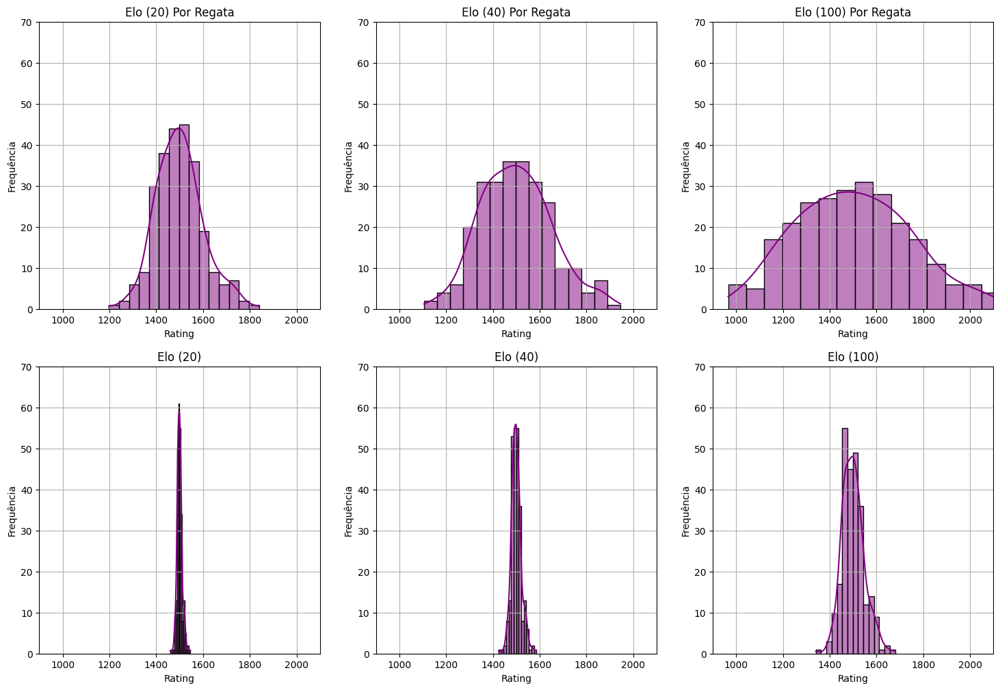

In [260]:
fig, axes = plt.subplots(2, 3, figsize=(18, 12))

sns.histplot(elo_20_iqfem["Rating"], bins=15, kde=True, color='purple', ax=axes[0, 0]);
axes[0, 0].set_xlim(900, 2100);
axes[0, 0].set_ylim(0, 70);
axes[0, 0].set_title('Elo (20) Por Regata')
axes[0, 0].set_xlabel('Rating');
axes[0, 0].set_ylabel('Frequência');
axes[0, 0].grid(True);

sns.histplot(elo_40_iqfem["Rating"], bins=15, kde=True, color='purple', ax=axes[0, 1]);
axes[0, 1].set_xlim(900, 2100);
axes[0, 1].set_ylim(0, 70);
axes[0, 1].set_title('Elo (40) Por Regata');
axes[0, 1].set_xlabel('Rating');
axes[0, 1].set_ylabel('Frequência');
axes[0, 1].grid(True);

sns.histplot(elo_100_iqfem["Rating"], bins=15, kde=True, color='purple', ax=axes[0, 2]);
axes[0, 2].set_xlim(900, 2100);
axes[0, 2].set_ylim(0, 70);
axes[0, 2].set_title('Elo (100) Por Regata');
axes[0, 2].set_xlabel('Rating');
axes[0, 2].set_ylabel('Frequência');
axes[0, 2].grid(True);

sns.histplot(elo_20_normal_iqfem["Rating"], bins=15, kde=True, color='purple', ax=axes[1, 0]);
axes[1, 0].set_xlim(900, 2100);
axes[1, 0].set_ylim(0, 70);
axes[1, 0].set_title('Elo (20)')
axes[1, 0].set_xlabel('Rating');
axes[1, 0].set_ylabel('Frequência');
axes[1, 0].grid(True);

sns.histplot(elo_40_normal_iqfem["Rating"], bins=15, kde=True, color='purple', ax=axes[1, 1]);
axes[1, 1].set_xlim(900, 2100);
axes[1, 1].set_ylim(0, 70);
axes[1, 1].set_title('Elo (40)')
axes[1, 1].set_xlabel('Rating');
axes[1, 1].set_ylabel('Frequência');
axes[1, 1].grid(True);

sns.histplot(elo_100_normal_iqfem["Rating"], bins=15, kde=True, color='purple', ax=axes[1, 2]);
axes[1, 2].set_xlim(900, 2100);
axes[1, 2].set_ylim(0, 70);
axes[1, 2].set_title('Elo (100)')
axes[1, 2].set_xlabel('Rating');
axes[1, 2].set_ylabel('Frequência');
axes[1, 2].grid(True);

# Giovanna Prada

In [268]:
elo_100_iqfem.head()

,Unnamed: 0,Rating
0,MARTA MAGGETTI,2125.651686
1,LOLA SORIN,2084.710628
2,MAYA MORRIS,2063.581985
3,PALMA CARGO,2062.396814
4,SHAHAR RESHEF,2040.141213


In [281]:
posicao_20 = elo_20_iqfem.index[elo_20_iqfem["Unnamed: 0"] == "GIOVANNA PRADA"].tolist()[0]
posicao_40 = elo_40_iqfem.index[elo_40_iqfem["Unnamed: 0"] == "GIOVANNA PRADA"].tolist()[0]
posicao_100 = elo_100_iqfem.index[elo_100_iqfem["Unnamed: 0"] == "GIOVANNA PRADA"].tolist()[0]

posicao_20_normal = elo_20_normal_iqfem.index[elo_20_normal_iqfem["Unnamed: 0"] == "GIOVANNA PRADA"].tolist()[0]
posicao_40_normal = elo_40_normal_iqfem.index[elo_40_normal_iqfem["Unnamed: 0"] == "GIOVANNA PRADA"].tolist()[0]
posicao_100_normal = elo_100_normal_iqfem.index[elo_100_normal_iqfem["Unnamed: 0"] == "GIOVANNA PRADA"].tolist()[0]

print("Número de Competidores IQFOIL Feminino: 255.\n")
print("Giovanna Prada:")
print(f"- Posição Elo 20: {posicao_20_normal}ª")
print(f"- Posição Elo 40: {posicao_40_normal}ª")
print(f"- Posição Elo 100: {posicao_100_normal}ª")

print(f"- Posição Elo 20 Por Regata: {posicao_20}ª")
print(f"- Posição Elo 40 Por Regata: {posicao_40}ª")
print(f"- Posição Elo 100 Por Regata: {posicao_100}ª")

Número de Competidores IQFOIL Feminino: 255.

Giovanna Prada:
- Posição Elo 20: 96ª
- Posição Elo 40: 101ª
- Posição Elo 100: 121ª
- Posição Elo 20 Por Regata: 152ª
- Posição Elo 40 Por Regata: 167ª
- Posição Elo 100 Por Regata: 176ª


# Fotografia

In [26]:
def fotografia_elo(data:pd.DataFrame, classe:str, ano:int, elo_k:int) -> pd.DataFrame:
    
    data_temp = data[data['Classe Vela'] == classe]

    for competition in data_temp['Nome Competição']:
            data_temp.loc[data_temp['Nome Competição'] == competition, 'Ano'] = int(re.findall(r'\d{4}', competition)[0])
    
    data_temp = data_temp[(data_temp['Ano'] <= ano)]

    elo = EloRating(ratings={competitor: 1500 for competitor in data_temp['Nome Competidor'].unique()}, k=elo_k)

    grouped_data = data_temp.groupby(["Ano", "Nome Competição", "Regata", "Nome Competidor"]).agg({"Posição Geral": "min"}).sort_values(by=["Ano", "Nome Competição", "Regata", "Posição Geral"], ascending=True).reset_index()

    data_dict = []
    for ano in grouped_data["Ano"].unique():
        for comp in grouped_data[grouped_data["Ano"] == ano]["Nome Competição"].unique():
            for regata in grouped_data[(grouped_data["Ano"] == ano) & (grouped_data["Nome Competição"] == comp)]["Regata"].unique():
                results = grouped_data[(grouped_data["Ano"] == ano) & (grouped_data["Nome Competição"] == comp) & (grouped_data["Regata"] == regata)]["Posição Geral"].values
                names = grouped_data[(grouped_data["Ano"] == ano) & (grouped_data["Nome Competição"] == comp) & (grouped_data["Regata"] == regata)]["Nome Competidor"].values
                data_dict.append([results, names])

    elo.fit(data_dict)
    ratings = elo.ratings

    ratings = pd.DataFrame.from_dict(ratings, orient='index', columns=['Rating']).sort_values(by="Rating", ascending=False)

    return ratings

In [104]:
def race_chart(classe:str, elo_k:int) -> None:

    dict_classe = dict()
    for cada_ano in range(2015, 2025):
        dict_classe[cada_ano] = fotografia_elo(data, classe, cada_ano, elo_k)
        dict_classe[cada_ano]["Ano"] = cada_ano

    df_classe = pd.DataFrame(columns=["Rating", "Ano"])
    for cada_ano in range(2015, 2025):
        df_classe = pd.concat([df_classe, dict_classe[cada_ano]], axis=0)

    df_classe = df_classe.reset_index()
    df_classe = df_classe.rename(columns={'index': 'Nome Atleta'})

    df_auxiliar = pd.DataFrame(columns=df_classe["Nome Atleta"].unique(), index=range(2015, 2025))

    for each_atleta in df_classe["Nome Atleta"].unique():
        for each_year in range(2015, 2025):
            data_aux = df_classe[(df_classe["Nome Atleta"] == each_atleta) & (df_classe["Ano"] == each_year)]

            try:
                df_auxiliar.at[each_year, each_atleta] = float(data_aux.iloc[0]['Rating'])
            except:
                df_auxiliar.at[each_year, each_atleta] = 0
    
    df_auxiliar = df_auxiliar.apply(pd.to_numeric, errors='ignore')
    
    return df_auxiliar

In [106]:
warnings.filterwarnings("ignore")

bcr.bar_chart_race(
    df=race_chart("ILCA 7", 40), 
    title=f'ELo 40 - ILCA 7', 
    orientation='h', 
    sort='desc', 
    n_bars=20, 
    steps_per_period=100, 
    period_length=2000,
    fixed_max=True,
    period_label={'x': .99, 'y': .1, 'ha': 'right', 'color': 'black'},
)

In [107]:
warnings.filterwarnings("ignore")

bcr.bar_chart_race(
    df=race_chart("ILCA 6", 40), 
    title=f'ELo 40 - ILCA 6', 
    orientation='h', 
    sort='desc', 
    n_bars=20, 
    steps_per_period=100, 
    period_length=2000,
    fixed_max=True,
    period_label={'x': .99, 'y': .1, 'ha': 'right', 'color': 'black'},
)

In [108]:
warnings.filterwarnings("ignore")

bcr.bar_chart_race(
    df=race_chart("49ER", 40), 
    title=f'ELo 40 - 49ER', 
    orientation='h', 
    sort='desc', 
    n_bars=20, 
    steps_per_period=100, 
    period_length=2000,
    fixed_max=True,
    period_label={'x': .99, 'y': .1, 'ha': 'right', 'color': 'black'},
)

In [110]:
warnings.filterwarnings("ignore")

bcr.bar_chart_race(
    df=race_chart("49ERFX", 40), 
    title=f'ELo 40 - 49ERFX', 
    orientation='h', 
    sort='desc', 
    n_bars=20, 
    steps_per_period=100, 
    period_length=2000,
    fixed_max=True,
    period_label={'x': .99, 'y': .1, 'ha': 'right', 'color': 'black'},
)

In [111]:
iqfoil = race_chart("IQFOIL FEM.", 40)

In [118]:
iqfoil = iqfoil.loc[[2021, 2022, 2023, 2024]]

In [119]:
warnings.filterwarnings("ignore")

bcr.bar_chart_race(
    df=iqfoil, 
    title=f'ELo 40 - IQFOIL FEM.', 
    orientation='h', 
    sort='desc', 
    n_bars=20, 
    steps_per_period=100, 
    period_length=2000,
    fixed_max=True,
    period_label={'x': .99, 'y': .1, 'ha': 'right', 'color': 'black'},
)

# Giovanna Prada

Alguns comportamentos estranhos, como a falta de variação dos rankings em alguns anos, é causada pela falta de alguns dados.

In [145]:
df_classe = pd.DataFrame(columns=["index", "Rating", "Ano"])

for cada_ano in range(2020, 2025):
    df_aux = fotografia_elo(data, "IQFOIL FEM.", cada_ano, 20)
    df_aux["Ano"] = cada_ano
    df_aux = df_aux.reset_index()  # Correção aqui
    df_classe = pd.concat([df_classe, df_aux], axis=0)

df_classe.index = df_classe.index + 1

df_classe[df_classe["index"] == "GIOVANNA PRADA"]

,index,Rating,Ano
21,GIOVANNA PRADA,1576.319949,2021
36,GIOVANNA PRADA,1570.647226,2022
153,GIOVANNA PRADA,1472.188012,2023
153,GIOVANNA PRADA,1472.188012,2024


In [143]:
df_classe = pd.DataFrame(columns=["index", "Rating", "Ano"])

for cada_ano in range(2020, 2025):
    df_aux = fotografia_elo(data, "IQFOIL FEM.", cada_ano, 40)
    df_aux["Ano"] = cada_ano
    df_aux = df_aux.reset_index()  # Correção aqui
    df_classe = pd.concat([df_classe, df_aux], axis=0)

df_classe.index = df_classe.index + 1

df_classe[df_classe["index"] == "GIOVANNA PRADA"]

,index,Rating,Ano
24,GIOVANNA PRADA,1615.887071,2021
41,GIOVANNA PRADA,1588.127516,2022
168,GIOVANNA PRADA,1428.448588,2023
168,GIOVANNA PRADA,1428.448588,2024


In [144]:
df_classe = pd.DataFrame(columns=["index", "Rating", "Ano"])

for cada_ano in range(2020, 2025):
    df_aux = fotografia_elo(data, "IQFOIL FEM.", cada_ano, 100)
    df_aux["Ano"] = cada_ano
    df_aux = df_aux.reset_index()  # Correção aqui
    df_classe = pd.concat([df_classe, df_aux], axis=0)

df_classe.index = df_classe.index + 1

df_classe[df_classe["index"] == "GIOVANNA PRADA"]

,index,Rating,Ano
25,GIOVANNA PRADA,1672.494571,2021
50,GIOVANNA PRADA,1602.824844,2022
177,GIOVANNA PRADA,1359.722294,2023
177,GIOVANNA PRADA,1359.722294,2024


# Problema dos Nomes

### Nomes Próximos

In [172]:
matriz_da_distancia = pd.DataFrame(columns=data["Nome Competidor"].unique(), index=data["Nome Competidor"].unique())

lista_nome_1 = list()
lista_nome_2 = list()
lista_dist = list()

def levenshtein_distance(string1, string2):
    return Levenshtein.distance(string1, string2)

for index1 in matriz_da_distancia.index:
    for index2 in matriz_da_distancia.columns:
        distance = levenshtein_distance(index1, index2)
        if distance <= 3 and distance > 0:
            lista_nome_1.append(index1)
            lista_nome_2.append(index2)
            lista_dist.append(distance)

        matriz_da_distancia.at[index1, index2] = distance

In [173]:
df_distance = pd.DataFrame()
df_distance["Nome 1"] = lista_nome_1
df_distance["Nome 2"] = lista_nome_2
df_distance["Distance"] = lista_dist

In [174]:
df_distance

,Nome 1,Nome 2,Distance
0,PILAR LAMADRID TRUEBA,PILAR LAMADRID-TRUEBA,1
1,PALMA ?ARGO,PALMA CARGO,1
2,MAYA MORRIS,MAC MORRIN,3
3,NICOLE VAN DER VELDEN,NICOLE VAN-DER-VELDEN,2
4,THERESA MARIE STEINLEIN,THERESA-MARIE STEINLEIN,1
...,...,...,...
363,MATHEW BARTON,MATTHEW BARTON,1
364,"YANG, HU","WANG, QI",3
365,"MAI, CHEN",HAO CHEN,3
366,"ZHAO, WANG","CHEN, WANG",3
